https://github.com/Azure/gen-cv/blob/main/image-embeddings/image-search-embeddings.ipynb

Install scikit-image , pycocotools

Two parts to image
- Image embeding
- Image text analysis


Two ways to do this
- sdk
- api

In [252]:
import os
import requests
import pickle
import faiss
import pandas as pd
import uuid
from typing import Dict, List
from pydantic import BaseModel, Extra, root_validator
import openai

from langchain.chat_models import AzureChatOpenAI
from langchain.agents import AgentExecutor
from langchain.callbacks.manager import CallbackManager
from langchain.agents import initialize_agent, AgentType
from langchain.tools import BaseTool
from langchain.utilities import BingSearchAPIWrapper

from common.callbacks import StdOutCallbackHandler
from common.prompts import BING_PROMPT_PREFIX

from IPython.display import Markdown, HTML, display  
from IPython.display import Image as IImage
import matplotlib.pyplot as plt
import math
from PIL import Image
from io import BytesIO

from dotenv import load_dotenv
load_dotenv("credentials.env")

# Lets define some helper functions
def printmd(string):
    display(Markdown(string.replace("$","USD ")))

def display_image(path):
    return IImage(path,width=500)

def save_obj_to_pkl(object, filename):
    with open(filename, 'wb') as pickle_out:
        pickle.dump(object, pickle_out)

def plot_images(img_list,cols=2,label_list=None):
    rows = int(math.ceil(len(img_list)/cols))
    fig = plt.figure(figsize=(cols * 4, rows * 4))
    for i, image_url in enumerate(img_list):
        plt.subplot(rows, cols,i+1)
        if image_url.startswith("http"):
            response = requests.get(image_url)
            img = Image.open(BytesIO(response.content))
        else:    
            img = Image.open(image_url)
        if label_list is None : plt.title(image_url)
        else: plt.title(label_list[i])
        plt.imshow(img)
        plt.axis('off')
    fig.tight_layout()
    plt.show()


# GPT-4 models are necessary for this feature. GPT-35-turbo will make mistakes multiple times on following system prompt instructions.
MODEL_DEPLOYMENT_NAME = "gpt-4-32k" 

In [2]:
# move these functions to Util or other common file
## CCO files
# https://github.com/cocodataset/cocoapi/blob/master/PythonAPI/pycocoDemo.ipynb
# https://cocodataset.org/#download
# How to download python https://stackoverflow.com/questions/51100191/how-can-i-download-a-specific-part-of-coco-dataset

from pycocotools.coco import COCO
import numpy as np
import skimage
import matplotlib.pyplot as plt
import pylab
import zipfile
import requests
import io
import json
from tqdm.notebook import tqdm
from requests.adapters import HTTPAdapter
from urllib3.util.retry import Retry

In [3]:

url_file = 'http://images.cocodataset.org/annotations/annotations_trainval2017.zip'
response = requests.get(url_file)

In [47]:
image_cats = ['dog','bear','elephant','bird','cat','giraffe','horse','sheep']
max_files = 15
session = requests.Session()
retry = Retry(connect=3, backoff_factor=0.5)
adapter = HTTPAdapter(max_retries=retry)
session.mount('http://', adapter)
session.mount('https://', adapter)
with zipfile.ZipFile(io.BytesIO(response.content)) as thezip:
    annotation_file = thezip.read('annotations/instances_val2017.json')
    coco = COCO()
    coco.dataset = json.loads(annotation_file.decode('utf-8'))
    coco.createIndex()
    for image_cat in image_cats:
        catIds = coco.getCatIds(catNms=image_cat)
        #print("catids {}".format(catIds))
        imgIds = coco.getImgIds(catIds=catIds )[0:max_files]        
        #print(imgIds)
        images = coco.loadImgs(imgIds)
        #os.makedirs(f"./data/images/{image_cat}", exist_ok=True)
        for img in tqdm(images,desc=image_cat):
            #if not os.path.isfile(f"./data/images/{image_cat}/{img['file_name']}"):
            if not os.path.isfile(f"./data/images/{img['file_name']}"):
                img_data = session.get(img['coco_url']).content
                with open(f"data/images/{img['file_name']}", 'wb') as handler:
                    handler.write(img_data)
    

creating index...
index created!


dog:   0%|          | 0/15 [00:00<?, ?it/s]

bear:   0%|          | 0/15 [00:00<?, ?it/s]

elephant:   0%|          | 0/15 [00:00<?, ?it/s]

bird:   0%|          | 0/15 [00:00<?, ?it/s]

cat:   0%|          | 0/15 [00:00<?, ?it/s]

giraffe:   0%|          | 0/15 [00:00<?, ?it/s]

horse:   0%|          | 0/15 [00:00<?, ?it/s]

sheep:   0%|          | 0/15 [00:00<?, ?it/s]

## Embeddings with Florence, OpenAI 
Now we will cregenerate 3 embeddings of the image
1. Image embedding using Florence
2. Text embedding of image analysis using Florence
3. Text embedding of image analysis using OpenAI

We will leverage REST API as it gives more flexibility while dealing with index etc. The libraries are also avalable in python and other languages.

In [73]:
# Setup the payload header
cv_img_stream_headers = {'Content-Type': 'application/octet-stream','Ocp-Apim-Subscription-Key': os.environ['AZURE_COMPUTER_VISION_KEY']}
#cv_text_headers = {'Content-Type': 'application/octet-stream','Ocp-Apim-Subscription-Key': os.environ['AZURE_COMPUTER_VISION_KEY']}
cv_text_headers = {'Content-Type': 'application/json','Ocp-Apim-Subscription-Key': os.environ['AZURE_COMPUTER_VISION_KEY']}
openai_embedding_headers = {'Content-Type': 'application/json','api-key': os.environ['AZURE_OPENAI_API_KEY']}
print(openai_embedding_headers)

{'Content-Type': 'application/json', 'api-key': '2d39342c86c44c428f4212b3054069a5'}


Lets first analyze one image using florance and get captions, objects, dense captions and tags. This will be used later for text embedding.

In [134]:
# https://learn.microsoft.com/en-us/rest/api/computervision/image-analysis/analyze-from-image-stream?view=rest-computervision-2023-02-01-preview&tabs=HTTP

def analyze_image(imagefile):
    model = "?api-version=2023-02-01-preview&overload=stream&features=tags,caption,objects,denseCaptions"
    url = os.environ['AZURE_COMPUTER_VISION_ENDPOINT'] + "computervision/imageanalysis:analyze" + model

    if imagefile.startswith("http"): # Read URL data
        r = requests.post(url, json={"url" : imagefile}, headers=cv_text_headers)
    else: # Read local the image file
        with open(imagefile, "rb") as f:
            data = f.read()
        r = requests.post(url, data=data, headers=cv_img_stream_headers)

    results = r.json()
    caption = results['captionResult']['text']
    tags_str = ", ".join([tag['name'] for tag in results['tagsResult']['values'] ])
    objects = ", ".join([  objtag['name'] for objects in results['objectsResult']['values'] for objtag in objects['tags'] ])
    dense_caption = ", ".join([ densecaption['text'] for densecaption in results['denseCaptionsResult']['values'] ])

    return ", ".join([caption, tags_str,objects,dense_caption])

analysis_text = analyze_image('./data/images/000000020247.jpg')
analysis_text

'a bear walking on a dirt road, outdoor, animal, mammal, ground, bear, brown bear, terrestrial animal, grizzly bear, kodiak bear, brown, fur, snout, wildlife, grizzly, brown bear, brown bear, a bear walking on a dirt road, a bear walking on the ground, a blurry image of a bear'

### Image embedding using Florance
Now lets get the image embeddings using florance. We will be using the Azure Computer's multi-model API Vision 4 for vectorization of images and text queries. It converts images to cordinates in mult-dimention vector space. 

In [88]:
# https://learn.microsoft.com/en-us/azure/ai-services/computer-vision/how-to/image-retrieval
# https://learn.microsoft.com/en-us/azure/ai-services/computer-vision/quickstarts-sdk/image-analysis-client-library-40?tabs=visual-studio%2Cwindows&pivots=programming-language-csharp
# https://learn.microsoft.com/en-us/rest/api/computervision/analyze-image/analyze-image?view=rest-computervision-v3.1&viewFallbackFrom=rest-computervision-2023-02-01-preview&tabs=HTTP

# https://learn.microsoft.com/en-us/azure/ai-services/computer-vision/how-to/call-analyze-image?tabs=rest
# https://eastus.dev.cognitive.microsoft.com/docs/services/Cognitive_Services_Unified_Vision_API_2023-10-01/operations/61d65934cd35050c20f73ab6

def get_image_embedding(imagefile):
    
    model = "?api-version=2023-02-01-preview&modelVersion=latest"
    url = os.environ['AZURE_COMPUTER_VISION_ENDPOINT'] + "computervision/retrieval:vectorizeImage" + model

    if imagefile.startswith("http"): # Read URL data
        r = requests.post(url, json={"url" : imagefile}, headers=cv_text_headers)
    else: # Read local the image file
        with open(imagefile, "rb") as f:
            data = f.read()
        r = requests.post(url, data=data, headers=cv_img_stream_headers)
        
    results = r.json()
    return results['vector']

#image_embedding = get_image_embedding('./data/images/000000020247.jpg') # KH Remove 
#image_embedding = get_image_embedding('https://www.nps.gov/yell/learn/nature/images/griz_sow.jpg')
#image_embedding # KH remove 

## Part I - Search Images by Image Embeddings using FAISS
We will create embeddings with Florance and the search using FAISS. To start with lets create dataframe with embeddings of all images and then build FAISS index to search images. To avoid re-generation of embedding everytime during testing, we will save it in local file.  

In [54]:
############# we may skip local copy
def get_img_embedding_df(root_dir,save_file_path='img_emb.pk'):

    df = pd.DataFrame(columns=['file', 'cv_image_vector', 'imgage_text'])

    for path,subdirs, files in os.walk(root_dir):
        for file in files:
            full_path = os.path.join(path,file)
            image_analysis = analyze_image(full_path)
            image_embedding = get_image_embedding(full_path)
            df.loc[len(df)] = [full_path, image_embedding, image_analysis]
    save_obj_to_pkl(df, save_file_path)
    return df


img_df = get_img_embedding_df('./data/images')

Create FAISS index fro image embeddings

In [147]:
def create_faiss_index(df,vector_column):
    img_emb_arr = np.vstack(df[vector_column])
    #img_path_arr = np.vstack(df['file'])
    faiss_img_index = faiss.IndexFlatL2(len(img_emb_arr[0]))
    faiss_img_index.add(img_emb_arr)

    #return img_path_arr, img_emb_arr, faiss_img_index
    #return img_emb_arr, faiss_img_index
    #return img_emb_arr, faiss_img_index
    return faiss_img_index

#img_path_arr, img_emb_arr, faiss_img_index = create_faiss_index(img_df)
#img_emb_arr, faiss_img_index = create_faiss_index(img_df,'cv_image_vector')
faiss_img_index = create_faiss_index(img_df,'cv_image_vector')

To search the images using Florence, get image embedding of the search image

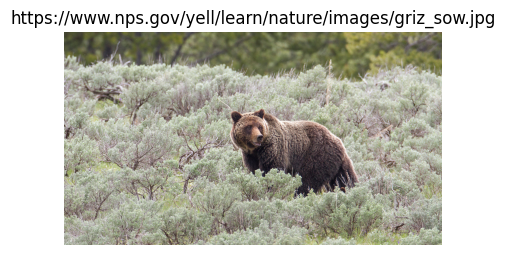

In [148]:
search_img_path = 'https://www.nps.gov/yell/learn/nature/images/griz_sow.jpg' 
plot_images([search_img_path])
search_image_imbedding = get_image_embedding(search_img_path)

In [149]:
def search_faiss_index(search_image_path, faiss_img_index, k=5):    
    search_img_embedding = get_image_embedding(search_image_path)
    img_embedding_2d = np.expand_dims(search_img_embedding, axis=0)
    iD, iI = faiss_img_index.search(img_embedding_2d, k)
    return iD[0], iI[0]

iD, iI =  search_faiss_index(search_img_path,faiss_img_index, k=5)    

print("Image Search Distances:", iD)

Image Search Distances: [2340.011  2351.657  2656.433  3129.6252 3616.3965]


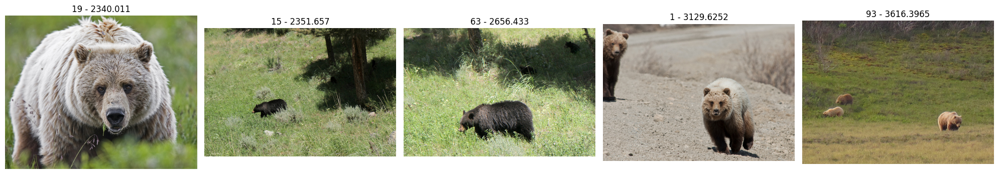

In [150]:
image_paths = img_df.loc[iI]['file'].tolist()
lables = [str(idx) + ' - ' + str(dist) for idx, dist in zip(iI, iD) ]
plot_images(image_paths,cols=5,label_list=lables)


## Part II - Search with Florance Image, text and OpenAI embeddings and FAISS
We how to do search using Florance Image embrdding and FAISS. Now lets evaluate validate using all 3 emneddings - Florance Image embedding, Florance text embeddings and openai embedding

We already know how to get image endbeddings. We will now get embeddings using Azure Conputer Vision 4 and OpenAI

### References:
OpenAI API https://learn.microsoft.com/en-us/azure/ai-services/openai/reference#embeddings

In [152]:
def get_text_embedding(text):    
    model = "?api-version=2023-02-01-preview&modelVersion=latest"
    url = os.environ['AZURE_COMPUTER_VISION_ENDPOINT'] + "computervision/retrieval:vectorizeText" + model

    data = {'text' : text}
    r = requests.post(url, data=json.dumps(data), headers=cv_text_headers)    
    return r.json()['vector']

def get_openai_embedding(text):
    model = "text-embedding-ada-002/embeddings?api-version=2023-08-01-preview"
    url = os.environ['AZURE_OPENAI_ENDPOINT'] + "/openai/deployments/" + model

    data = {'input' : text}
    r = requests.post(url, data=json.dumps(data), headers=openai_embedding_headers)
    return r.json()['data'][0]['embedding']

#get_text_embedding('fdfj ljsldjls ljdjs ljls')
#get_openai_embedding('This is bird')

Create dataframe with all 3 embeddings - Florance Image embedding, FLorance text embeddings and openai emnedding.

In [154]:
def get_analysis_and_embeddings(image_path):
    analysis_text = analyze_image(image_path)
    image_embedding = get_image_embedding(image_path)
    text_embedding = get_text_embedding(analysis_text)
    openai_embedding = get_openai_embedding(analysis_text)
    return analysis_text, image_embedding, text_embedding, openai_embedding
    

def get_embedding_df(root_dir,save_file_path='all_img_emb.pk'):

    df = pd.DataFrame(columns=['file', 'cv_image_vector', 'imgage_text', 'cv_text_vector','openai_text_vector'])

    for path,subdirs, files in os.walk(root_dir):
        for file in files:
            full_path = os.path.join(path,file)
            analysis_text, image_embedding, text_embedding, openai_embedding = get_analysis_and_embeddings(full_path)
            df.loc[len(df)] = [full_path, image_embedding, analysis_text,text_embedding,openai_embedding]
    save_obj_to_pkl(df, save_file_path)
    return df

img_embeddings_df = get_embedding_df('./data/images')

In [224]:
# Review dataframe
# display(img_embeddings_df)

,file,cv_image_vector,imgage_text,cv_text_vector,openai_text_vector
0,./data/images\000000000285.jpg,"[-0.2619629, 2.578125, 1.4902344, -0.042755127...","a bear sitting in the grass, bear, mammal, out...","[-0.0049598753, 0.020364331, 0.002922044, -0.0...","[0.0014461469, -0.0036941485, -0.002759691, -0..."
1,./data/images\000000020247.jpg,"[0.3491211, -0.7866211, -0.20349121, 0.8666992...","a bear walking on a dirt road, outdoor, animal...","[0.01312493, -0.009015664, -0.01486374, -0.023...","[-0.0027806372, -0.0040643727, -0.0043991227, ..."
2,./data/images\000000023937.jpg,"[0.6166992, 2.4101562, 3.078125, 1.7177734, -0...","a cow lying in the grass, grass, outdoor, tree...","[-0.008302654, -0.004721964, -0.00425478, -0.0...","[-0.032166723, -0.00052912044, -0.02088304, -0..."
3,./data/images\000000029187.jpg,"[-2.2089844, -1.3994141, -1.1523438, -0.322265...","a horse and jockey pulling a cart, outdoor, ho...","[-0.010786115, -0.035203286, 0.0031382546, -0....","[-0.011886474, -0.0024427574, 0.0020493364, -0..."
4,./data/images\000000032811.jpg,"[2.7460938, 0.76953125, 3.34375, -1.8222656, 1...","a bird on a window, window, lake, water, bird,...","[0.017653855, -0.015776766, 0.00046252843, -0....","[-0.023011973, -0.018992981, -0.010579025, -0...."
...,...,...,...,...,...
113,./data/images\000000546829.jpg,"[4.8125, -0.053375244, -0.94970703, 1.2070312,...","a dog on a bench, outdoor, tree, ground, plant...","[0.014039675, -0.005999905, 0.0028494769, 0.01...","[-0.011164416, -0.011895037, -0.013330646, -0...."
114,./data/images\000000553990.jpg,"[-0.13427734, -2.4863281, -7.0585938, 0.865722...","a woman riding a horse over a hurdle, outdoor,...","[0.017655207, -0.047913097, -0.042502716, 0.02...","[-0.019369768, -0.0026891695, -0.008458132, -0..."
115,./data/images\000000554002.jpg,"[-1.5283203, 0.07562256, -1.3701172, 2.265625,...","a dog standing in a line, footwear, person, ou...","[-0.028584927, -0.004411016, -0.001292172, 0.0...","[-0.016833242, -0.0073490837, -0.012550074, -0..."
116,./data/images\000000560266.jpg,"[-1.4814453, 0.94091797, -0.71533203, 0.511230...","two bears in the water, animal, mammal, water,...","[-0.007108752, -0.024872037, -0.0035579118, -0...","[-0.012716223, -0.013601929, -0.001659119, -0...."


Create FAISS indexes

In [155]:
image_faiss_index = create_faiss_index(img_embeddings_df,'cv_image_vector')
text_faiss_index = create_faiss_index(img_embeddings_df,'cv_text_vector')
openai_faiss_index = create_faiss_index(img_embeddings_df,'openai_text_vector')

Search the Images using all 3 embeddings

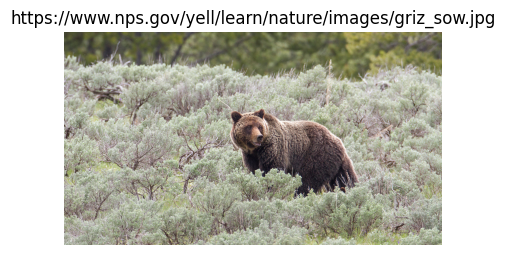

In [174]:
search_img_path = 'https://www.nps.gov/yell/learn/nature/images/griz_sow.jpg'
plot_images([search_img_path])
analysis_text, image_embedding, text_embedding, openai_embedding = get_analysis_and_embeddings(search_img_path)

Search using Florance Image embedding

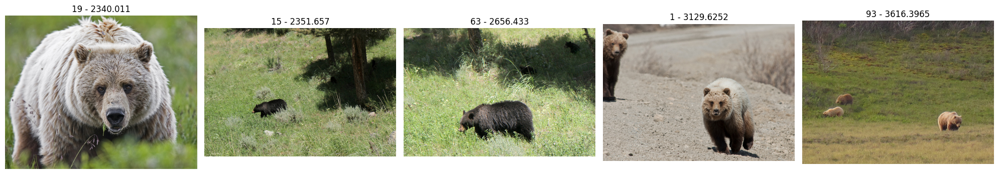

In [171]:
img_embedding_2d = np.expand_dims(image_embedding, axis=0)
iD, iI = image_faiss_index.search(img_embedding_2d, k=5)

image_paths = img_embeddings_df.loc[iI[0]]['file'].tolist()
lables_i = [str(idx) + ' - ' + str(dist) for idx, dist in zip(iI[0], iD[0]) ]
plot_images(image_paths,cols=5,label_list=lables_i)

Serach using text embeding

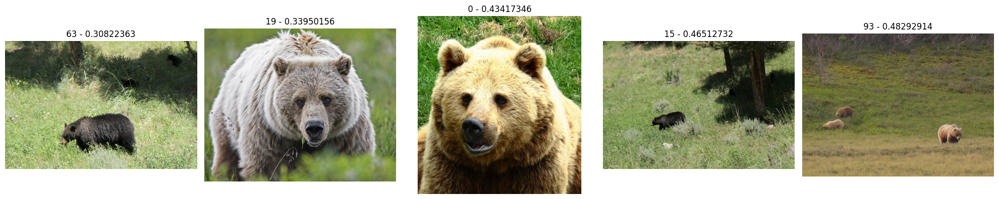

In [172]:
txt_embedding_2d = np.expand_dims(text_embedding, axis=0)
iD, iI = text_faiss_index.search(txt_embedding_2d, k=5)

image_paths = img_embeddings_df.loc[iI[0]]['file'].tolist()
lables_txt = [str(idx) + ' - ' + str(dist) for idx, dist in zip(iI[0], iD[0]) ]
plot_images(image_paths,cols=5,label_list=lables_txt)

Search OpenAI embeddings

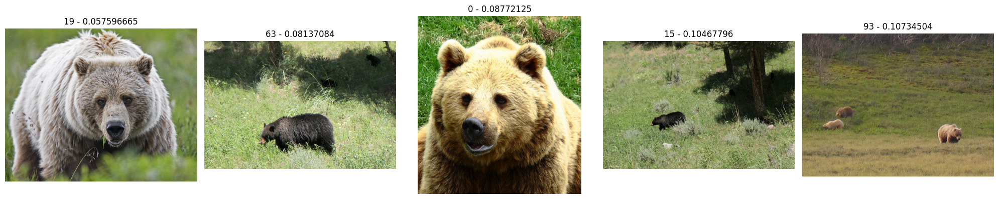

In [173]:
oai_embedding_2d = np.expand_dims(openai_embedding, axis=0)
iD, iI = openai_faiss_index.search(oai_embedding_2d, k=5)

image_paths = img_embeddings_df.loc[iI[0]]['file'].tolist()
lables_openai = [str(idx) + ' - ' + str(dist) for idx, dist in zip(iI[0], iD[0]) ]
plot_images(image_paths,cols=5,label_list=lables_openai)

## Part III - Using Azure search

In this section we will store a vector in a Azure Search and use semantic search. This will integrate very well with Azure services and provides best search capability.

First we will create index in Azure search. Index hold 3 vector fields one for each emneddings (1) 'cv_image_vector'- a vector for Florence image embedding (2) 'cv_text_vector' - a vactor for Florence text emnedding and (3) 'openai_text_vector' - a vector for OpenAI embedding.

### Reference
https://learn.microsoft.com/en-us/azure/search/vector-search-how-to-create-index?tabs=config-2023-10-01-Preview%2Crest-2023-11-01%2Cpush%2Cportal-check-index


In [200]:
image_index_name = "cogsrch-index-image-vector"

In [227]:
### Create Azure Search Vector-based Index
# Setup the Payloads header
azure_search_headers = {'Content-Type': 'application/json','api-key': os.environ['AZURE_SEARCH_KEY']}
#params = {'api-version': os.environ['AZURE_SEARCH_API_VERSION']}
#params = {'api-version': '2023-10-01-Preview'} 
params = {'api-version': '2023-11-01'}

In [220]:
image_index_payload = {
    "name": image_index_name,
    "fields": [
        {"name": "id", "type": "Edm.String", "key": "true", "filterable": "true" },        
        {"name": "file","type": "Edm.String","searchable": "true","retrievable": "true","filterable": 'true',"sortable": "true","facetable": "true"},
        {"name": "text","type": "Edm.String","searchable": "true","retrievable": "true","filterable": 'true',"sortable": "true","facetable": "true"},
        {"name": "cv_image_vector","type": "Collection(Edm.Single)","searchable": "true","retrievable": "true","dimensions": 1024,"vectorSearchProfile": "image-vector-profile"},
        {"name": "cv_text_vector","type": "Collection(Edm.Single)","searchable": "true","retrievable": "true","dimensions": 1024,"vectorSearchProfile": "image-vector-profile"},
        {"name": "openai_text_vector","type": "Collection(Edm.Single)","searchable": "true","retrievable": "true","dimensions": 1536,"vectorSearchProfile": "image-vector-profile"}        
    ],
    "similarity": {
        "@odata.type": "#Microsoft.Azure.Search.BM25Similarity",
        "k1": None,
        "b": None
    },
    "corsOptions": {
        "allowedOrigins": [
            "*"
        ],
        "maxAgeInSeconds": 60
    },
    "vectorSearch": {
        "algorithms": [
            {
                "name": "image-vector-Config",
                "kind": "hnsw",
                "hnswParameters": {
                    "m": 10,
                    "efConstruction": 400,
                    "metric": "cosine"
                }
            }
        ],
        "profiles": [
            {
                "name": "image-vector-profile",
                "algorithm": "image-vector-Config"
            }
        ]
    },
    "semantic": {
        "defaultConfiguration": None,
        "configurations": [
            {
                "name": "img-semantic-config",
                "prioritizedFields": {
                    "prioritizedContentFields": [
                        {
                            "fieldName": "text"
                        }
                    ],
                    "prioritizedKeywordsFields": []
                }
            }
        ]
    }
}

# KVH API can be changed to latest 2023-10-01 instead of 2023-07-01-preview
r = requests.put(os.environ['AZURE_SEARCH_ENDPOINT'] + "/indexes/" + image_index_name,
                 data=json.dumps(image_index_payload), headers=azure_search_headers, params=params)
print(r.status_code)
print(r.ok)

201
True


We altready have the data in dataframe. Upload the data to Azure Search

In [225]:
def upload_documents(img_embeddings_df):
    image_payload = {"value":[]}
    for i, doc in img_embeddings_df.iterrows():
        doc_dict = {}
        doc_dict["id"] = str(uuid.uuid4())
        doc_dict["file"] = doc.get("file", [])
        doc_dict["text"] = doc.get("imgage_text", [])
        doc_dict["openai_text_vector"] = doc.get("openai_text_vector", [])
        doc_dict['cv_image_vector'] = doc.get('cv_image_vector', [])
        doc_dict['cv_text_vector'] = doc.get('cv_text_vector', [])
        doc_dict["@search.action"] = "upload"
        #if i == 1
        image_payload['value'].append(doc_dict)
    #print(image_payload)
    try:
        r = requests.post(os.environ['AZURE_SEARCH_ENDPOINT'] + "/indexes/" + image_index_name + "/docs/index",
                                    data=json.dumps(image_payload), headers=azure_search_headers, params=params)
        if r.status_code != 200:
            print(r.status_code)
            print(r.text)
    except Exception as e:
        print("Exception:",e)

upload_documents(img_embeddings_df)

In [214]:
#openai_embedding

Search the image

In [233]:
# Modify for hybrid/semantic
def search_image(search_value,index,vector_name="openai_text_vector",k=5):
    search_payload = {
        "select": "id,file,text",        
        "filter": None, 
        "vectorQueries" : [
            {
                "kind" : "vector",
                "vector": search_value,
                "exhaustive": "true",
                "fields": vector_name,
                "k": k
            }
        ]
    }

    resp = requests.post(os.environ['AZURE_SEARCH_ENDPOINT'] + "/indexes/" + index + "/docs/search",
                         json=search_payload, headers=azure_search_headers, params=params)

    search_results = resp.json()
    if 'value' in search_results:
        return search_results['value']
    else:
        print(search_results)
    

For vector search we need to pass vedtor embeddingd for search image. Lets get vectors embeddings of search image


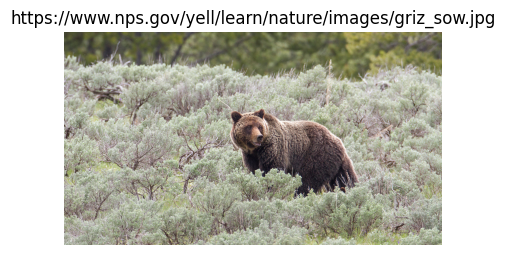

'a bear in a field of bushes, outdoor, mammal, animal, bear, brown bear, tree, grizzly bear, terrestrial animal, kodiak bear, wildlife, grizzly, black bear, brown, plant, field, brown bear, a bear in a field of bushes, a bear standing in the bushes'

In [249]:
search_img_path = 'https://www.nps.gov/yell/learn/nature/images/griz_sow.jpg'
plot_images([search_img_path])
analysis_text, image_embedding, text_embedding, openai_embedding = get_analysis_and_embeddings(search_img_path)
analysis_text

Search using Florance image embedding vector

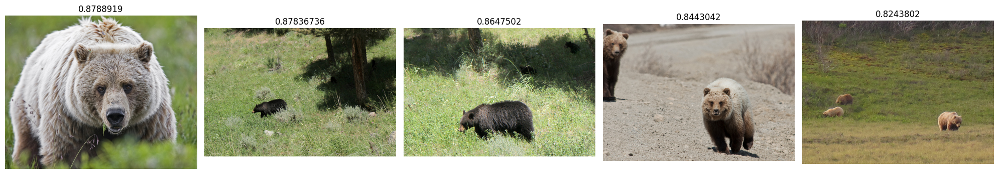

In [244]:
cog_search_img_result = search_image(image_embedding,image_index_name,vector_name="cv_image_vector")

image_paths = [image['file'] for image in cog_search_img_result]
lables_img = [image['@search.score'] for image in cog_search_img_result]
plot_images(image_paths,cols=5,label_list=lables_img)

Search using Florance text embedding vector

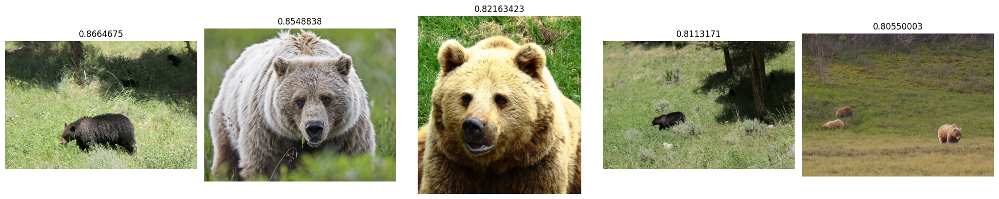

In [245]:
cog_search_txt_result = search_image(text_embedding,image_index_name,vector_name="cv_text_vector")

image_paths = [image['file'] for image in cog_search_txt_result]
lables_txt = [image['@search.score'] for image in cog_search_txt_result]
plot_images(image_paths,cols=5,label_list=lables_txt)

Search using OpenAI Embedding vector

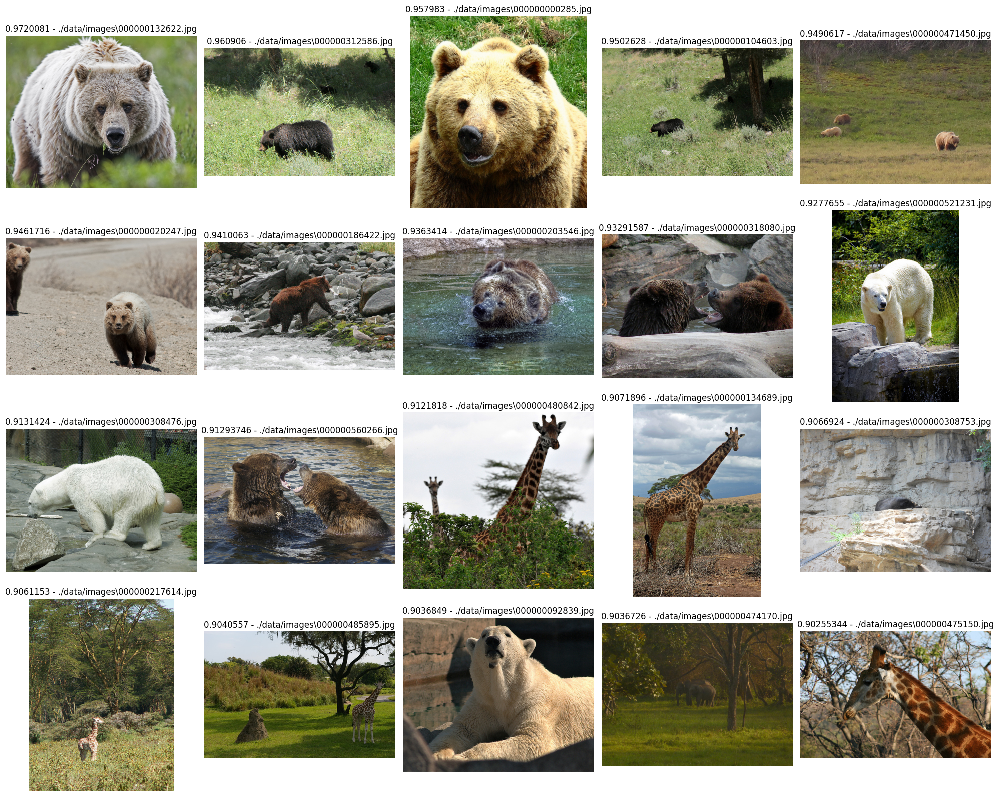

In [257]:
cog_search_openai_result = search_image(openai_embedding,image_index_name,vector_name="openai_text_vector",k=20)

image_paths = [image['file'] for image in cog_search_openai_result]
lables_openai = [str(image['@search.score'])+ " - " + image['file']  for image in cog_search_openai_result]
plot_images(image_paths,cols=5,label_list=lables_openai)

## Part IV = Use of OpenAI to further filter search result and provide more accurate results.

In [258]:
context = ["\n [" + image['file'] + "] " + image['text']  for image in cog_search_openai_result]
context

['\n [./data/images\\000000132622.jpg] a bear in the grass, mammal, animal, bear, outdoor, grass, terrestrial animal, brown bear, kodiak bear, grizzly bear, snout, wildlife, fur, black bear, grizzly, brown, field, brown bear, a bear in the grass, a bear in the grass',
 '\n [./data/images\\000000312586.jpg] a bear walking in the grass, outdoor, grass, animal, mammal, bear, plant, terrestrial animal, wildlife, brown bear, black bear, field, grizzly bear, nature reserve, kodiak bear, black, brown, grizzly, bear, a bear walking in the grass, a black bear in the grass',
 '\n [./data/images\\000000000285.jpg] a bear sitting in the grass, bear, mammal, outdoor, animal, grass, brown bear, terrestrial animal, kodiak bear, grizzly bear, snout, brown, wildlife, fur, grizzly, field, zoo, brown bear, a bear sitting in the grass, a bear sitting in the grass',
 '\n [./data/images\\000000104603.jpg] a black bear in a grassy area, outdoor, grass, mammal, animal, bear, plant, tree, wildlife, nature rese

In [270]:
os.environ["OPENAI_API_BASE"] = os.environ["AZURE_OPENAI_ENDPOINT"]
os.environ["OPENAI_API_KEY"] = os.environ["AZURE_OPENAI_API_KEY"]
os.environ["OPENAI_API_VERSION"] = os.environ["AZURE_OPENAI_API_VERSION"]
os.environ["OPENAI_API_TYPE"] = "azure"

def chat_openai(prompt, completion_model, max_output_tokens = 500):
    if not isinstance(prompt, list):
        prompt = [{'role':'user', 'content': prompt}]

    resp = openai.ChatCompletion.create(
            messages=prompt,
            temperature=0.2,
            max_tokens=max_output_tokens,
            engine = completion_model
        )

    #print(resp)
    return resp["choices"][0]["message"]['content'].strip(" \n")

In [271]:
query = " Get grizzly bear "
prompt = f"""Assistant is a large language model trained by OpenAI and is super factual and details oriented. 
The assistant must answer the Question, and must look for answers within the provided Context below, both delineated by 3 backticks.

```
Context: {' '.join(context)}
```

```
Question: from the Context above, please return the search results and the source links that are most relevant to the following query: {query }
Please respond with your analysis directly in JSON format (without using Markdown code blocks or any other formatting).
The JSON schema should include: {{'file' : ' source link', 'text' " 'source information'}}
```

Answer:
"""

response_json = json.loads(chat_openai(prompt, 'gpt-4', max_output_tokens = 1000))


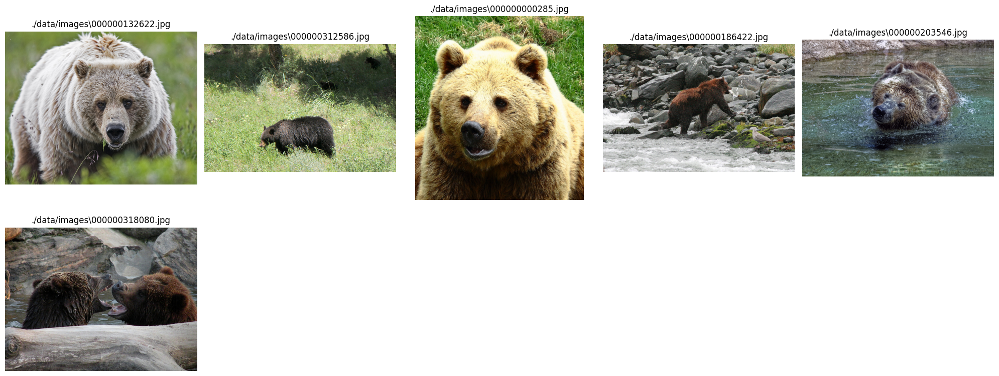

In [273]:
image_paths = [image['file'] for image in response_json]

plot_images(image_paths,cols=5)

### Testing

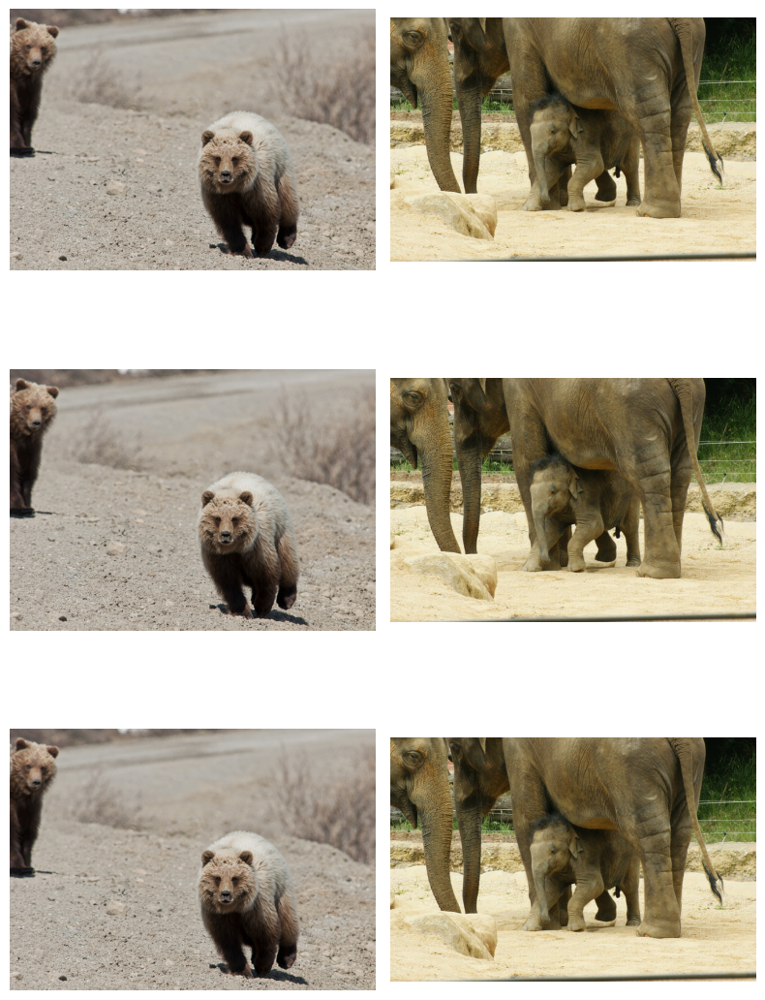

In [70]:

#display_image('./data/images/000000020247.jpg')
#display_image('https://www.nps.gov/yell/learn/nature/images/griz_sow.jpg')
#plot_images(['https://www.nps.gov/yell/learn/nature/images/griz_sow.jpg'])
plot_images(['./data/images/000000020247.jpg','./data/images/000000110638.jpg','./data/images/000000020247.jpg','./data/images/000000110638.jpg','./data/images/000000020247.jpg','./data/images/000000110638.jpg'])